In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import librosa
import librosa.display
import IPython.display as ipd
from IPython.display import Audio
import IPython
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import Sequential

In [ ]:
daf = pd.read_csv('features_3_sec.csv')
data_dir = '/content/drive/MyDrive/music dataset/genres_original'
music_cls = ['blues','classical','country','disco','hiphop','jazz','metal','pop','reggae','rock']

In [ ]:
daf.head()

,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
0,blues.00000.0.wav,66149,0.335406,0.091048,0.130405,0.003521,1773.065032,167541.630869,1972.744388,117335.771563,...,39.687145,-3.241280,36.488243,0.722209,38.099152,-5.050335,33.618073,-0.243027,43.771767,blues
1,blues.00000.1.wav,66149,0.343065,0.086147,0.112699,0.001450,1816.693777,90525.690866,2010.051501,65671.875673,...,64.748276,-6.055294,40.677654,0.159015,51.264091,-2.837699,97.030830,5.784063,59.943081,blues
2,blues.00000.2.wav,66149,0.346815,0.092243,0.132003,0.004620,1788.539719,111407.437613,2084.565132,75124.921716,...,67.336563,-1.768610,28.348579,2.378768,45.717648,-1.938424,53.050835,2.517375,33.105122,blues
3,blues.00000.3.wav,66149,0.363639,0.086856,0.132565,0.002448,1655.289045,111952.284517,1960.039988,82913.639269,...,47.739452,-3.841155,28.337118,1.218588,34.770935,-3.580352,50.836224,3.630866,32.023678,blues
4,blues.00000.4.wav,66149,0.335579,0.088129,0.143289,0.001701,1630.656199,79667.267654,1948.503884,60204.020268,...,30.336359,0.664582,45.880913,1.689446,51.363583,-3.392489,26.738789,0.536961,29.146694,blues


In [ ]:
daf.describe()

,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,rolloff_mean,...,mfcc16_mean,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var
count,9990.0,9990.000000,9990.000000,9990.000000,9.990000e+03,9990.000000,9.990000e+03,9990.000000,9.990000e+03,9990.000000,...,9990.000000,9990.000000,9990.000000,9990.000000,9990.000000,9990.000000,9990.000000,9990.000000,9990.000000,9990.000000
mean,66149.0,0.379534,0.084876,0.130859,2.676388e-03,2199.219431,4.166727e+05,2241.385959,1.182711e+05,4566.076592,...,1.448240,49.988755,-4.198706,51.962753,0.739943,52.488851,-2.497306,54.973829,-0.917584,57.322614
std,0.0,0.090466,0.009637,0.068545,3.585628e-03,751.860611,4.349644e+05,543.854449,1.013505e+05,1642.065335,...,5.735149,34.442816,5.677379,36.400669,5.181313,38.177120,5.111799,41.585677,5.253243,46.444212
min,66149.0,0.107108,0.015345,0.000953,4.379535e-08,472.741636,8.118813e+02,499.162910,1.183520e+03,658.336276,...,-26.850016,1.325786,-27.809795,1.624544,-20.733809,3.437439,-27.448456,3.065302,-35.640659,0.282131
25%,66149.0,0.315698,0.079833,0.083782,6.145900e-04,1630.680158,1.231961e+05,1887.455790,4.876553e+04,3378.311110,...,-2.227478,29.584894,-7.951722,29.863448,-2.516638,29.636197,-5.734123,30.496412,-4.004475,30.011365
50%,66149.0,0.384741,0.085108,0.121253,1.491318e-03,2208.628236,2.650692e+05,2230.575595,8.996072e+04,4631.377892,...,1.461623,41.702393,-4.443021,42.393583,0.733772,41.831377,-2.702366,43.435253,-1.030939,44.332155
75%,66149.0,0.442443,0.091092,0.176328,3.130862e-03,2712.581884,5.624152e+05,2588.340505,1.585674e+05,5591.634521,...,5.149752,59.274619,-0.726945,61.676964,3.888734,62.033906,0.514246,65.328602,2.216603,68.210421
max,66149.0,0.749481,0.120964,0.442567,3.261522e-02,5432.534406,4.794119e+06,3708.147554,1.235143e+06,9487.446477,...,39.144405,683.932556,34.048843,529.363342,36.970322,629.729797,31.365425,1143.230591,34.212101,910.473206


In [ ]:
daf.isnull().sum()

,0
filename,0
length,0
chroma_stft_mean,0
chroma_stft_var,0
rms_mean,0
rms_var,0
spectral_centroid_mean,0
spectral_centroid_var,0
spectral_bandwidth_mean,0
spectral_bandwidth_var,0


In [ ]:
daf.shape

(9990, 60)

In [ ]:
daf['label'].unique()

array(['blues', 'classical', 'country', 'disco', 'hiphop', 'jazz',
       'metal', 'pop', 'reggae', 'rock'], dtype=object)

In [ ]:
daf.dtypes

,0
filename,object
length,int64
chroma_stft_mean,float64
chroma_stft_var,float64
rms_mean,float64
rms_var,float64
spectral_centroid_mean,float64
spectral_centroid_var,float64
spectral_bandwidth_mean,float64
spectral_bandwidth_var,float64


In [ ]:
daf.columns

Index(['filename', 'length', 'chroma_stft_mean', 'chroma_stft_var', 'rms_mean',
       'rms_var', 'spectral_centroid_mean', 'spectral_centroid_var',
       'spectral_bandwidth_mean', 'spectral_bandwidth_var', 'rolloff_mean',
       'rolloff_var', 'zero_crossing_rate_mean', 'zero_crossing_rate_var',
       'harmony_mean', 'harmony_var', 'perceptr_mean', 'perceptr_var', 'tempo',
       'mfcc1_mean', 'mfcc1_var', 'mfcc2_mean', 'mfcc2_var', 'mfcc3_mean',
       'mfcc3_var', 'mfcc4_mean', 'mfcc4_var', 'mfcc5_mean', 'mfcc5_var',
       'mfcc6_mean', 'mfcc6_var', 'mfcc7_mean', 'mfcc7_var', 'mfcc8_mean',
       'mfcc8_var', 'mfcc9_mean', 'mfcc9_var', 'mfcc10_mean', 'mfcc10_var',
       'mfcc11_mean', 'mfcc11_var', 'mfcc12_mean', 'mfcc12_var', 'mfcc13_mean',
       'mfcc13_var', 'mfcc14_mean', 'mfcc14_var', 'mfcc15_mean', 'mfcc15_var',
       'mfcc16_mean', 'mfcc16_var', 'mfcc17_mean', 'mfcc17_var', 'mfcc18_mean',
       'mfcc18_var', 'mfcc19_mean', 'mfcc19_var', 'mfcc20_mean', 'mfcc20_var',
  

In [ ]:
audio = 'reggae.00001.wav'
genre = 'reggae'
audio_path = f"{data_dir}/{genre}/{audio}"
data,sr=librosa.load(audio_path)
print(type(data),type(sr))

<class 'numpy.ndarray'> <class 'int'>


In [ ]:
IPython.display.Audio(data,rate=sr)

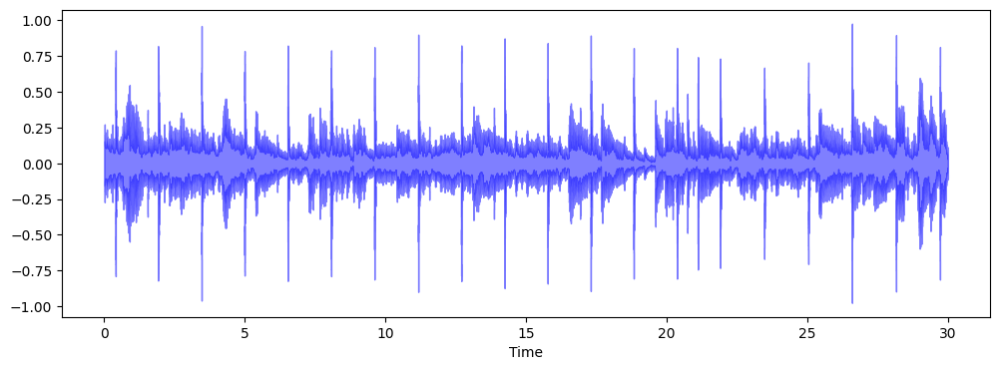

In [ ]:
plt.figure(figsize=(12,4))
librosa.display.waveshow(data,color='#0000ff', alpha=0.5)
plt.show()

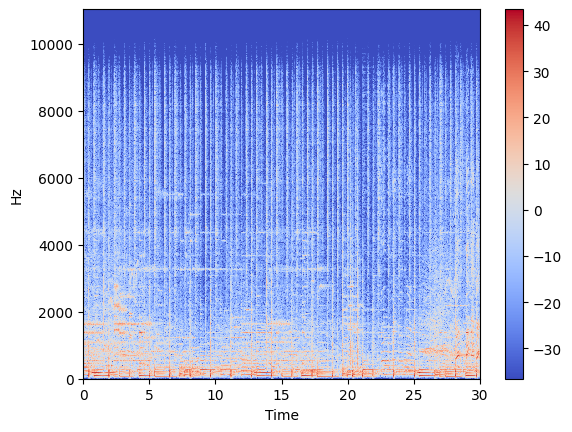

In [ ]:
stft = librosa.stft(data)
stft_db = librosa.amplitude_to_db(abs(stft))

plt.figure()
librosa.display.specshow(stft_db, sr=sr, x_axis='time', y_axis='hz')
plt.colorbar()

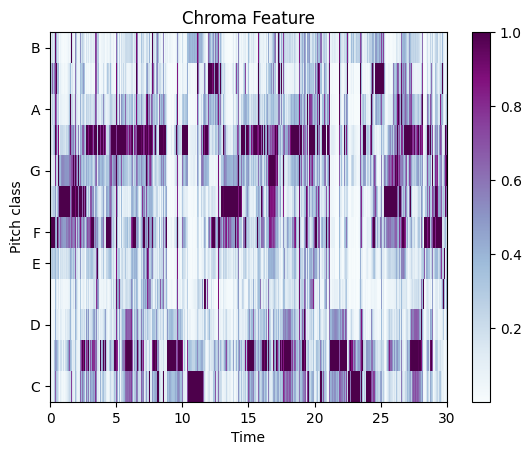

In [ ]:
chroma = librosa.feature.chroma_stft(y=data,sr=sr)

plt.figure()
librosa.display.specshow(chroma, sr=sr, x_axis='time', y_axis='chroma',cmap='BuPu')
plt.colorbar()
plt.title("Chroma Feature")
plt.show()

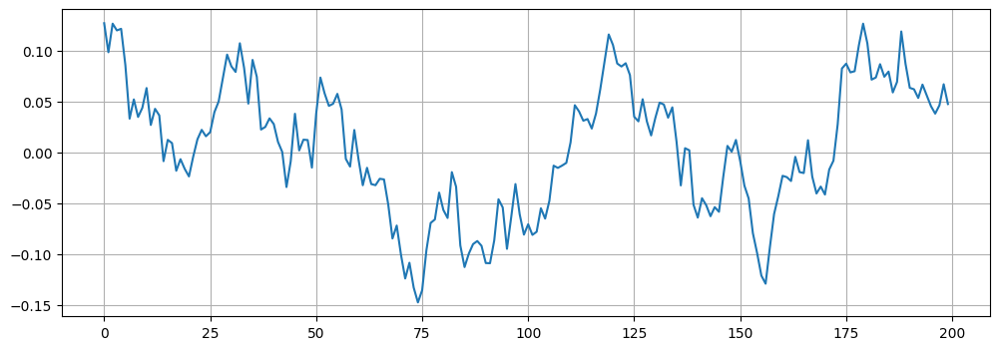

In [ ]:
start = 1000
end = 1200
plt.figure(figsize=(12,4))
plt.plot(data[start:end])
plt.grid()

In [ ]:
zero_cross_rate=librosa.zero_crossings(data[start:end],pad=False)
print("The number of zero_crossings are :", sum(zero_cross_rate))

The number of zero_crossings are : 20


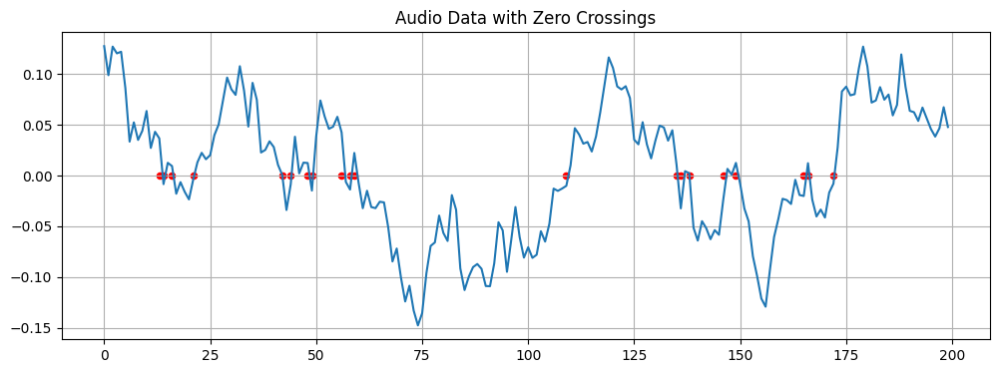

In [ ]:
plt.figure(figsize=(12, 4))
plt.plot(data[start:end])

zero_crossings = np.where(np.diff(np.sign(data[start:end])))[0]

plt.scatter(zero_crossings, np.zeros(len(zero_crossings)), color='red', s=20)

plt.grid()
plt.title("Audio Data with Zero Crossings")
plt.show()

## EDA of all type of genere

### BLUES

In [ ]:
audio = 'blues.00040.wav'
genre = 'blues'
audio_path = f"{data_dir}/{genre}/{audio}"
data,sr = librosa.load(audio_path)
print(type(data),type(sr))

<class 'numpy.ndarray'> <class 'int'>


In [ ]:
IPython.display.Audio(data,rate=sr)

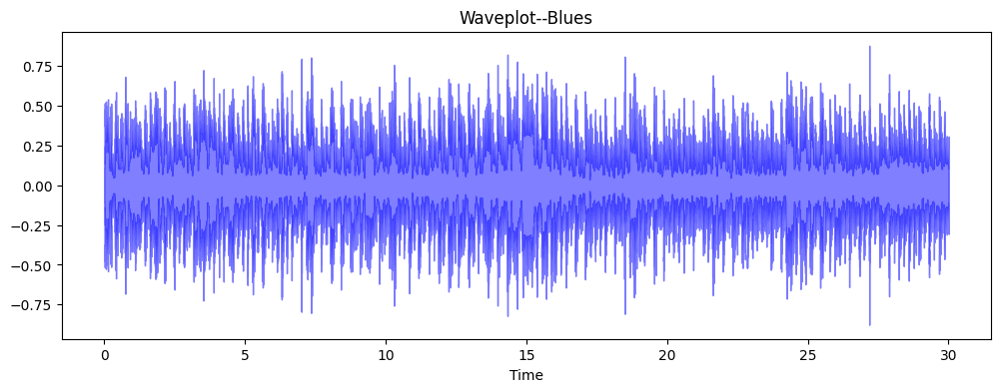

In [ ]:
plt.figure(figsize=(12,4))
librosa.display.waveshow(data, sr=sr, alpha=0.5, color = '#0000ff')
plt.title("Waveplot--Blues")
plt.show()

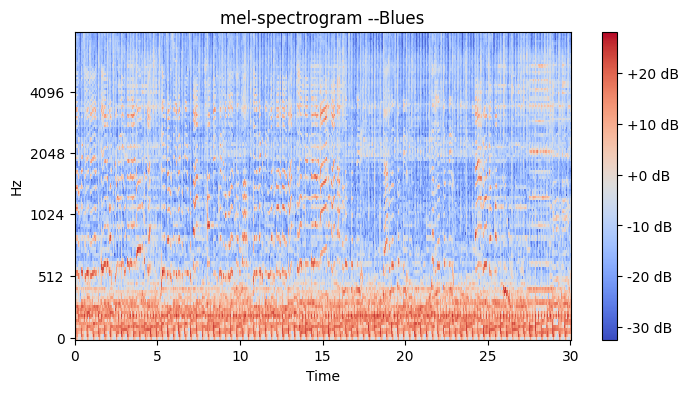

In [ ]:
# log mel-spectogram
plt.figure(figsize=(8,4))
mel = librosa.feature.melspectrogram(y=data,sr=sr,n_mels=128,fmax=8000)
mel = librosa.power_to_db(mel)
librosa.display.specshow(mel, sr=sr, x_axis='time', y_axis='mel',fmax=8000)
plt.title("mel-spectrogram --Blues")
plt.colorbar(format = '%+2.0f dB')
plt.show()

### ROCK

In [ ]:
audio = 'rock.00001.wav'
genre = 'rock'
audio_path = f"{data_dir}/{genre}/{audio}"
data,sr = librosa.load(audio_path)
print(type(data),type(sr))

<class 'numpy.ndarray'> <class 'int'>


In [ ]:
IPython.display.Audio(data,rate=sr)

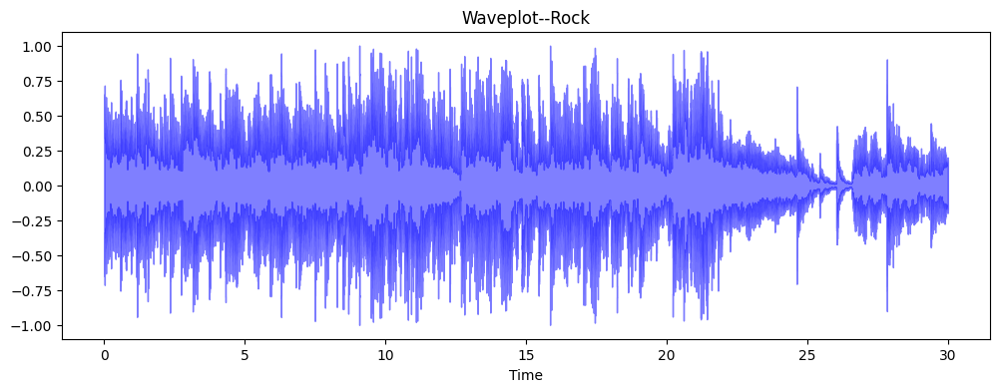

In [ ]:
plt.figure(figsize=(12,4))
librosa.display.waveshow(data, sr=sr, alpha=0.5, color = '#0000ff')
plt.title("Waveplot--Rock")
plt.show()

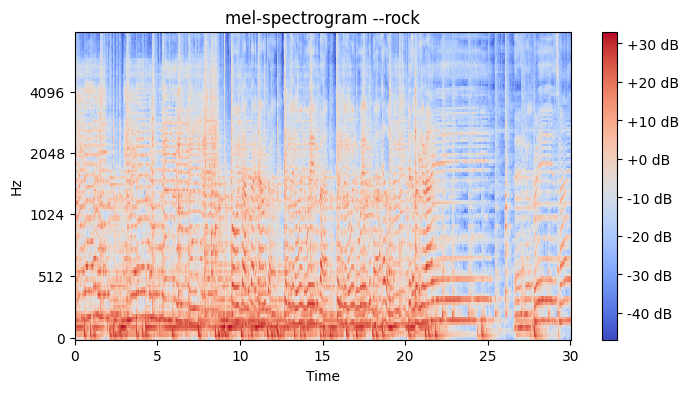

In [ ]:
# log mel-spectogram
plt.figure(figsize=(8,4))
mel = librosa.feature.melspectrogram(y=data,sr=sr,n_mels=128,fmax=8000)
mel = librosa.power_to_db(mel)
librosa.display.specshow(mel, sr=sr, x_axis='time', y_axis='mel',fmax=8000)
plt.title("mel-spectrogram --rock")
plt.colorbar(format = '%+2.0f dB')
plt.show()

### CLASSICAL

In [ ]:
audio = 'classical.00001.wav'
genre = 'classical'
audio_path = f"{data_dir}/{genre}/{audio}"
data,sr = librosa.load(audio_path)
print(type(data),type(sr))

<class 'numpy.ndarray'> <class 'int'>


In [ ]:
IPython.display.Audio(data,rate=sr)

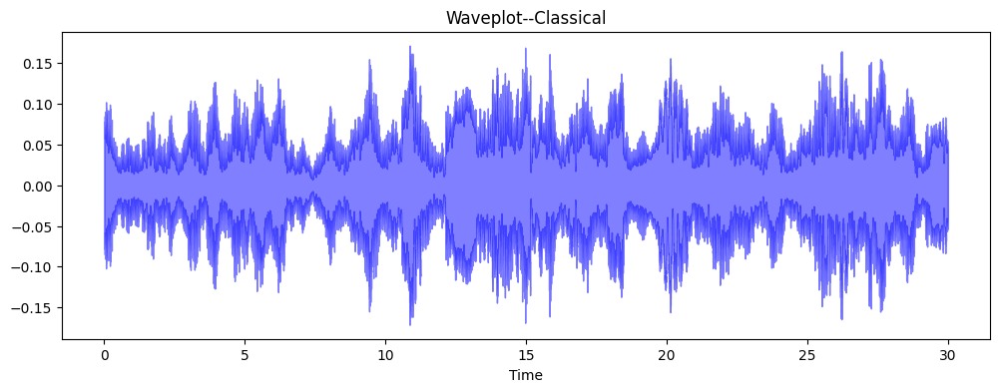

In [ ]:
plt.figure(figsize=(12,4))
librosa.display.waveshow(data, sr=sr, alpha=0.5, color = '#0000ff')
plt.title("Waveplot--Classical")
plt.show()

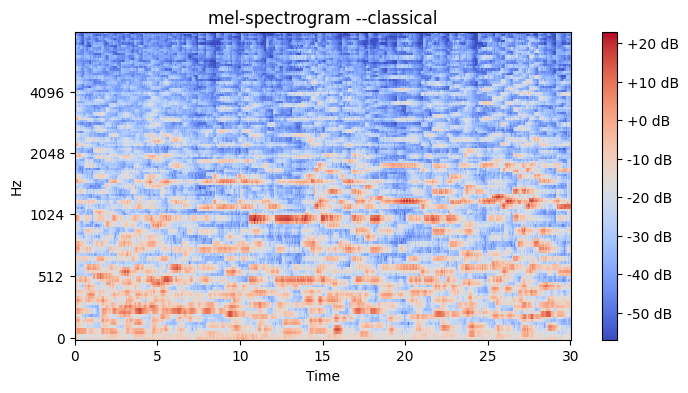

In [ ]:
# log mel-spectogram
plt.figure(figsize=(8,4))
mel = librosa.feature.melspectrogram(y=data,sr=sr,n_mels=128,fmax=8000)
mel = librosa.power_to_db(mel)
librosa.display.specshow(mel, sr=sr, x_axis='time', y_axis='mel',fmax=8000)
plt.title("mel-spectrogram --classical")
plt.colorbar(format = '%+2.0f dB')
plt.show()

## COUNTRY

In [ ]:
audio = 'country.00001.wav'
genre = 'country'
audio_path = f"{data_dir}/{genre}/{audio}"
data,sr = librosa.load(audio_path)
print(type(data),type(sr))

<class 'numpy.ndarray'> <class 'int'>


In [ ]:
IPython.display.Audio(data,rate=sr)

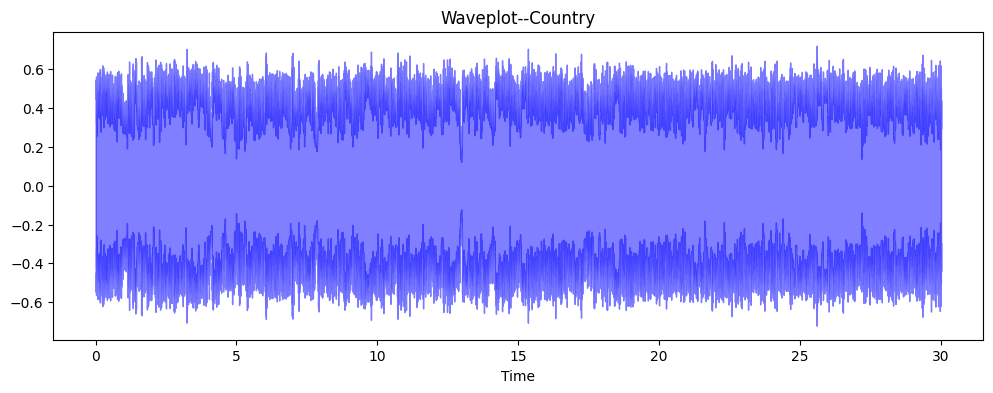

In [ ]:
plt.figure(figsize=(12,4))
librosa.display.waveshow(data, sr=sr, alpha=0.5, color = '#0000ff')
plt.title("Waveplot--Country")
plt.show()

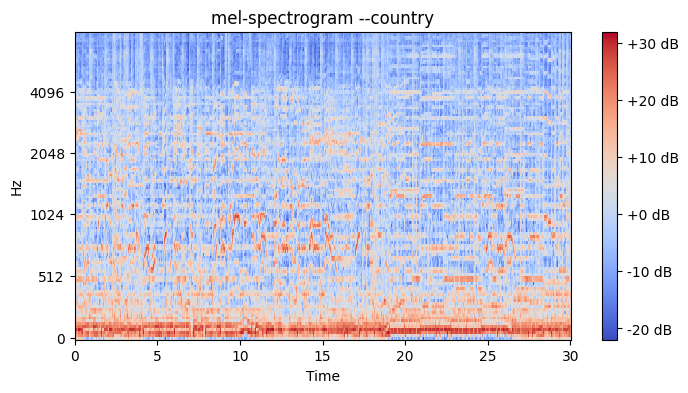

In [ ]:
# log mel-spectogram
plt.figure(figsize=(8,4))
mel = librosa.feature.melspectrogram(y=data,sr=sr,n_mels=128,fmax=8000)
mel = librosa.power_to_db(mel)
librosa.display.specshow(mel, sr=sr, x_axis='time', y_axis='mel',fmax=8000)
plt.title("mel-spectrogram --country")
plt.colorbar(format = '%+2.0f dB')
plt.show()

## DISCO

In [ ]:
audio = 'disco.00001.wav'
genre = 'disco'
audio_path = f"{data_dir}/{genre}/{audio}"
data,sr = librosa.load(audio_path)
print(type(data),type(sr))

<class 'numpy.ndarray'> <class 'int'>


In [ ]:
IPython.display.Audio(data,rate=sr)

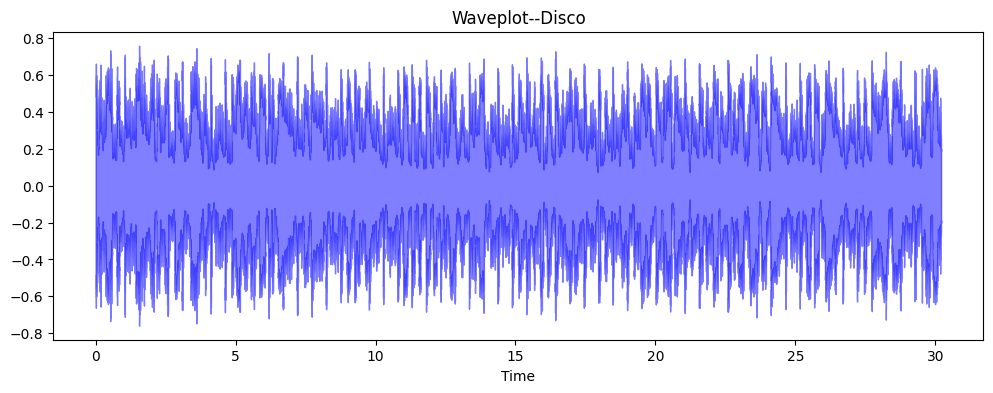

In [ ]:
plt.figure(figsize=(12,4))
librosa.display.waveshow(data, sr=sr, alpha=0.5, color = '#0000ff')
plt.title("Waveplot--Disco")
plt.show()

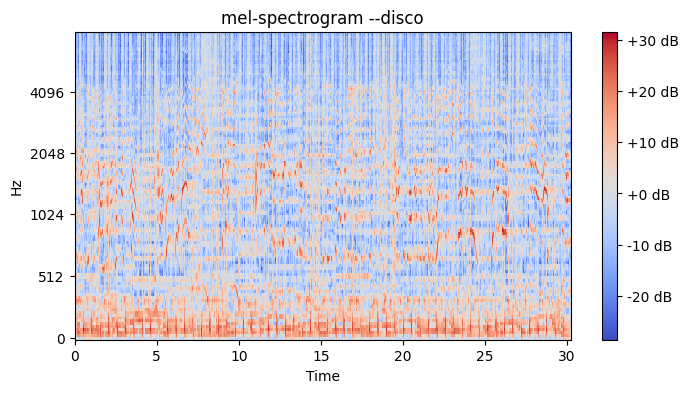

In [ ]:
plt.figure(figsize=(8,4))
mel = librosa.feature.melspectrogram(y=data,sr=sr,n_mels=128,fmax=8000)
mel = librosa.power_to_db(mel)
librosa.display.specshow(mel, sr=sr, x_axis='time', y_axis='mel',fmax=8000)
plt.title("mel-spectrogram --disco")
plt.colorbar(format = '%+2.0f dB')
plt.show()

## HIPHOP

In [ ]:
audio = 'hiphop.00001.wav'
genre = 'hiphop'
audio_path = f"{data_dir}/{genre}/{audio}"
data,sr = librosa.load(audio_path)
print(type(data),type(sr))

<class 'numpy.ndarray'> <class 'int'>


In [ ]:
IPython.display.Audio(data,rate=sr)

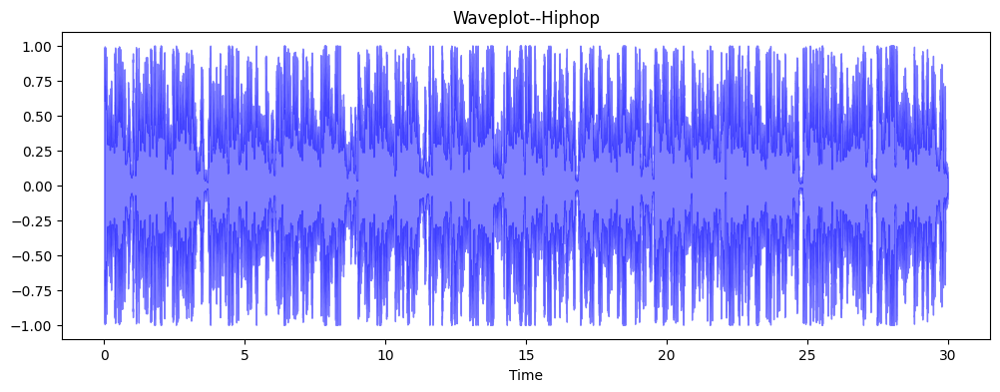

In [ ]:
plt.figure(figsize=(12,4))
librosa.display.waveshow(data, sr=sr, alpha=0.5, color = '#0000ff')
plt.title("Waveplot--Hiphop")
plt.show()

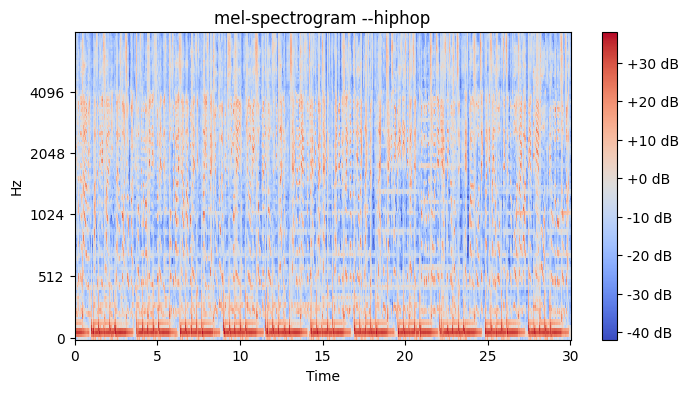

In [ ]:
plt.figure(figsize=(8,4))
mel = librosa.feature.melspectrogram(y=data,sr=sr,n_mels=128,fmax=8000)
mel = librosa.power_to_db(mel)
librosa.display.specshow(mel, sr=sr, x_axis='time', y_axis='mel',fmax=8000)
plt.title("mel-spectrogram --hiphop")
plt.colorbar(format = '%+2.0f dB')
plt.show()

## JAZZ

In [ ]:
audio = 'jazz.00001.wav'
genre = 'jazz'
audio_path = f"{data_dir}/{genre}/{audio}"
data,sr = librosa.load(audio_path)
print(type(data),type(sr))

<class 'numpy.ndarray'> <class 'int'>


In [ ]:
IPython.display.Audio(data,rate=sr)

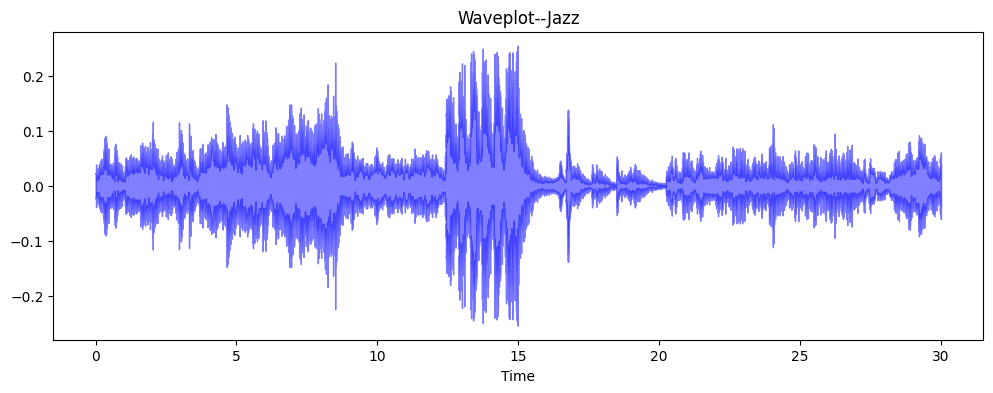

In [ ]:
plt.figure(figsize=(12,4))
librosa.display.waveshow(data, sr=sr, alpha=0.5, color = '#0000ff')
plt.title("Waveplot--Jazz")
plt.show()

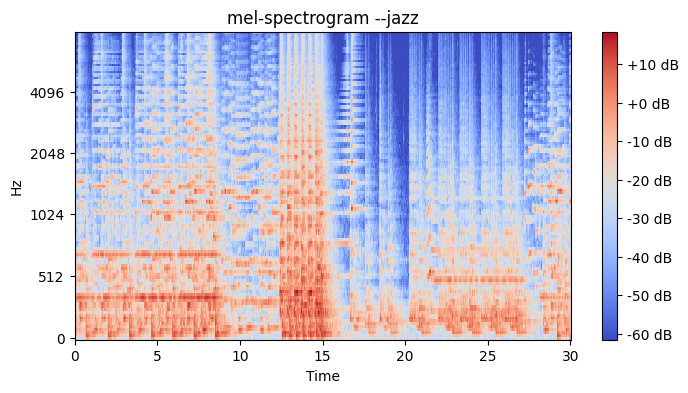

In [ ]:
plt.figure(figsize=(8,4))
mel = librosa.feature.melspectrogram(y=data,sr=sr,n_mels=128,fmax=8000)
mel = librosa.power_to_db(mel)
librosa.display.specshow(mel, sr=sr, x_axis='time', y_axis='mel',fmax=8000)
plt.title("mel-spectrogram --jazz")
plt.colorbar(format = '%+2.0f dB')
plt.show()

## METAL

In [ ]:
audio = 'metal.00001.wav'
genre = 'metal'
audio_path = f"{data_dir}/{genre}/{audio}"
data,sr = librosa.load(audio_path)
print(type(data),type(sr))

<class 'numpy.ndarray'> <class 'int'>


In [ ]:
IPython.display.Audio(data,rate=sr)

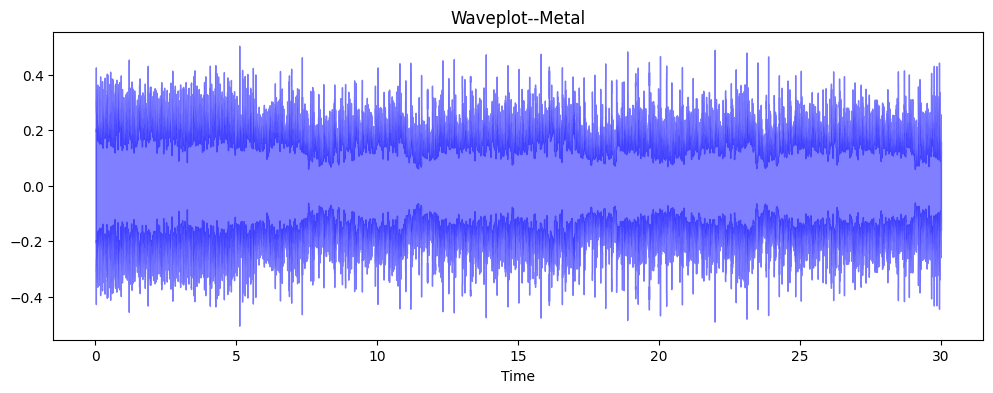

In [ ]:
plt.figure(figsize=(12,4))
librosa.display.waveshow(data, sr=sr, alpha=0.5, color = '#0000ff')
plt.title("Waveplot--Metal")
plt.show()

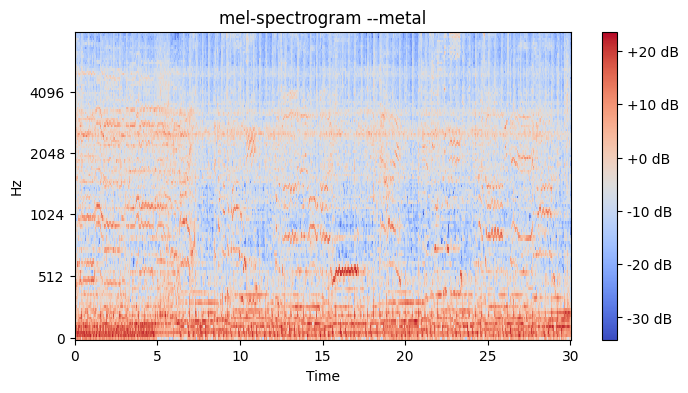

In [ ]:
plt.figure(figsize=(8,4))
mel = librosa.feature.melspectrogram(y=data,sr=sr,n_mels=128,fmax=8000)
mel = librosa.power_to_db(mel)
librosa.display.specshow(mel, sr=sr, x_axis='time', y_axis='mel',fmax=8000)
plt.title("mel-spectrogram --metal")
plt.colorbar(format = '%+2.0f dB')
plt.show()

## POP

In [ ]:
audio = 'pop.00001.wav'
genre = 'pop'
audio_path = f"{data_dir}/{genre}/{audio}"
data,sr = librosa.load(audio_path)
print(type(data),type(sr))

<class 'numpy.ndarray'> <class 'int'>


In [ ]:
IPython.display.Audio(data,rate=sr)

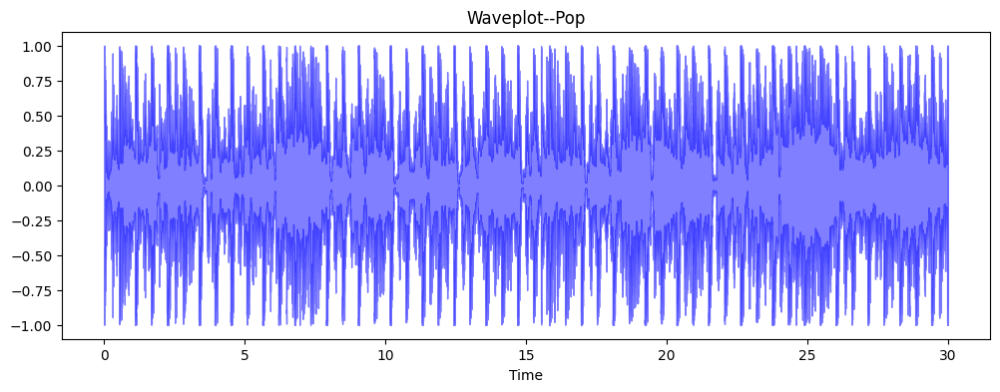

In [ ]:
plt.figure(figsize=(12,4))
librosa.display.waveshow(data, sr=sr, alpha=0.5, color = '#0000ff')
plt.title("Waveplot--Pop")
plt.show()

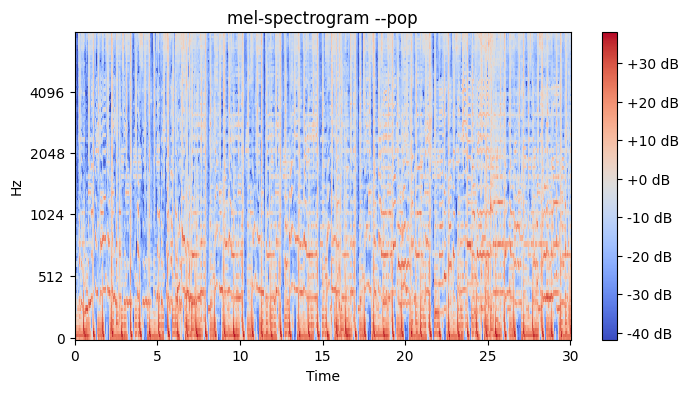

In [ ]:
plt.figure(figsize=(8,4))
mel = librosa.feature.melspectrogram(y=data,sr=sr,n_mels=128,fmax=8000)
mel = librosa.power_to_db(mel)
librosa.display.specshow(mel, sr=sr, x_axis='time', y_axis='mel',fmax=8000)
plt.title("mel-spectrogram --pop")
plt.colorbar(format = '%+2.0f dB')
plt.show()

## REGGAE

In [ ]:
audio = 'reggae.00001.wav'
genre = 'reggae'
audio_path = f"{data_dir}/{genre}/{audio}"
data,sr = librosa.load(audio_path)
print(type(data),type(sr))

<class 'numpy.ndarray'> <class 'int'>


In [ ]:
IPython.display.Audio(data,rate=sr)

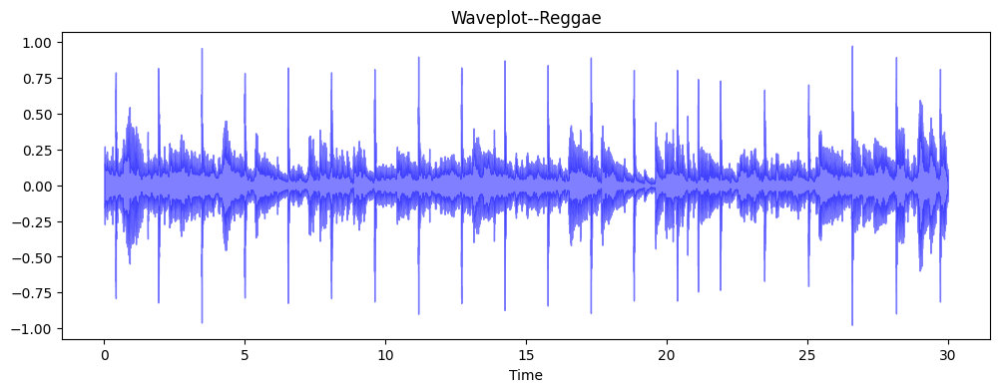

In [ ]:
plt.figure(figsize=(12,4))
librosa.display.waveshow(data, sr=sr, alpha=0.5, color = '#0000ff')
plt.title("Waveplot--Reggae")
plt.show()

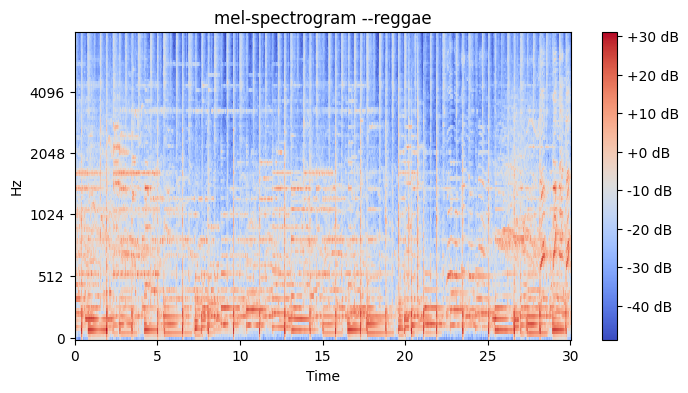

In [ ]:
plt.figure(figsize=(8,4))
mel = librosa.feature.melspectrogram(y=data,sr=sr,n_mels=128,fmax=8000)
mel = librosa.power_to_db(mel)
librosa.display.specshow(mel, sr=sr, x_axis='time', y_axis='mel',fmax=8000)
plt.title("mel-spectrogram --reggae")
plt.colorbar(format = '%+2.0f dB')
plt.show()

In [ ]:
print("Columns containing missing values",list(daf.columns[daf.isnull().any()]))

Columns containing missing values []


## Label Encoding

In [ ]:
# Blues - 0
# Classical - 1
# Country - 2
# Disco - 3
# Hip-hop - 4
# Jazz - 5
# Metal - 6
# Pop - 7
# Reggae - 8
# Rock - 9

class_encod=daf.iloc[:,-1]
converter=LabelEncoder()
y=converter.fit_transform(class_encod)
y

array([0, 0, 0, ..., 9, 9, 9])

In [ ]:
print(daf.iloc[:,:-1])

               filename  length  chroma_stft_mean  chroma_stft_var  rms_mean  \
0     blues.00000.0.wav   66149          0.335406         0.091048  0.130405   
1     blues.00000.1.wav   66149          0.343065         0.086147  0.112699   
2     blues.00000.2.wav   66149          0.346815         0.092243  0.132003   
3     blues.00000.3.wav   66149          0.363639         0.086856  0.132565   
4     blues.00000.4.wav   66149          0.335579         0.088129  0.143289   
...                 ...     ...               ...              ...       ...   
9985   rock.00099.5.wav   66149          0.349126         0.080515  0.050019   
9986   rock.00099.6.wav   66149          0.372564         0.082626  0.057897   
9987   rock.00099.7.wav   66149          0.347481         0.089019  0.052403   
9988   rock.00099.8.wav   66149          0.387527         0.084815  0.066430   
9989   rock.00099.9.wav   66149          0.369293         0.086759  0.050524   

       rms_var  spectral_centroid_mean 

In [ ]:
daf = daf.drop(labels='filename',axis=1)

## Scaling

In [ ]:
from sklearn.preprocessing import StandardScaler
fit=StandardScaler()
X=fit.fit_transform(np.array(daf.iloc[:,:-1],dtype=float))

In [ ]:
X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.3)

In [ ]:
print("X_train:",len(X_train))
print("X_test:",len(X_test))
print('y_train:',len(y_train))
print('y_test:',len(y_test))

X_train: 6993
X_test: 2997
y_train: 6993
y_test: 2997


## KNN

Training set score: 0.954
Test set score: 0.885
              precision    recall  f1-score   support

           0       0.85      0.91      0.88       297
           1       0.91      0.93      0.92       323
           2       0.77      0.87      0.82       279
           3       0.83      0.89      0.86       302
           4       0.91      0.87      0.89       288
           5       0.90      0.85      0.87       294
           6       0.98      0.95      0.96       293
           7       0.95      0.85      0.90       308
           8       0.90      0.91      0.90       320
           9       0.89      0.80      0.84       293

    accuracy                           0.88      2997
   macro avg       0.89      0.88      0.88      2997
weighted avg       0.89      0.88      0.89      2997



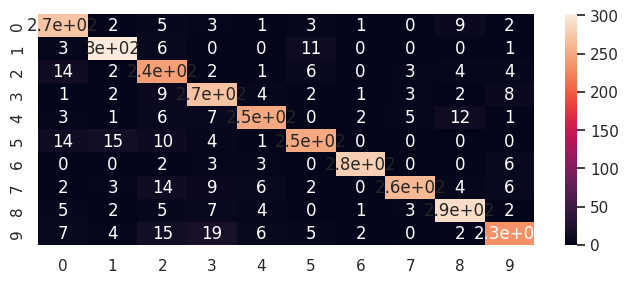

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

clf1=KNeighborsClassifier(n_neighbors=3)
clf1.fit(X_train,y_train)
y_pred=clf1.predict(X_test)
print("Training set score: {:.3f}".format(clf1.score(X_train, y_train)))
print("Test set score: {:.3f}".format(clf1.score(X_test, y_test)))
cf_matrix = confusion_matrix(y_test, y_pred)
sns.set(rc = {'figure.figsize':(8,3)})
sns.heatmap(cf_matrix, annot=True)
print(classification_report(y_test,y_pred))

Training set score: 0.924
Test set score: 0.838
              precision    recall  f1-score   support

           0       0.83      0.83      0.83       297
           1       0.88      0.96      0.92       323
           2       0.76      0.81      0.78       279
           3       0.78      0.78      0.78       302
           4       0.92      0.80      0.86       288
           5       0.84      0.88      0.86       294
           6       0.89      0.94      0.91       293
           7       0.89      0.87      0.88       308
           8       0.85      0.82      0.84       320
           9       0.72      0.67      0.69       293

    accuracy                           0.84      2997
   macro avg       0.84      0.84      0.84      2997
weighted avg       0.84      0.84      0.84      2997



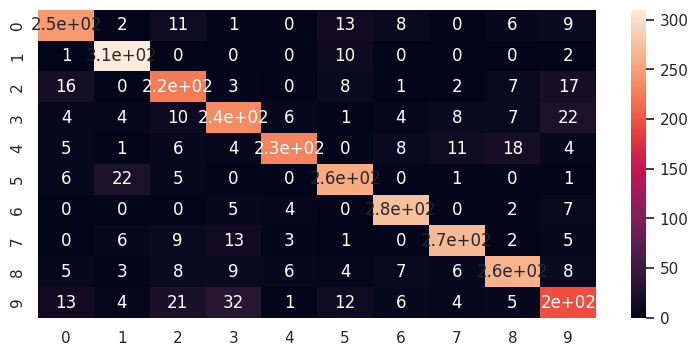

In [ ]:
from sklearn.svm import SVC
svclassifier = SVC(kernel='rbf', degree=8)
svclassifier.fit(X_train, y_train)
print("Training set score: {:.3f}".format(svclassifier.score(X_train, y_train)))
print("Test set score: {:.3f}".format(svclassifier.score(X_test, y_test)))
y_pred = svclassifier.predict(X_test)
cf_matrix3 = confusion_matrix(y_test, y_pred)
sns.set(rc = {'figure.figsize':(9,4)})
sns.heatmap(cf_matrix3, annot=True)
print(classification_report(y_test, y_pred))

In [ ]:
model = tf.keras.models.Sequential([
    tf.keras.layers.Flatten(input_shape=(X_train.shape[1],)),
    tf.keras.layers.Dropout(0.2),

    tf.keras.layers.Dense(512, activation='relu'),
    tf.keras.layers.Dropout(0.2),

    tf.keras.layers.Dense(256, activation='relu'),
    tf.keras.layers.Dropout(0.2),

    tf.keras.layers.Dense(128, activation='relu'),
    tf.keras.layers.Dropout(0.2),

    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dropout(0.2),

    tf.keras.layers.Dense(32, activation='relu'),
    tf.keras.layers.Dropout(0.2),

    tf.keras.layers.Dense(10, activation='softmax')
])

optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001)
model.compile(optimizer=optimizer, loss='sparse_categorical_crossentropy', metrics=['accuracy'])

model.summary()

/usr/local/lib/python3.12/dist-packages/keras/src/layers/reshaping/flatten.py:37: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ flatten (Flatten)               │ (None, 58)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 58)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 512)            │        30,208 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 256)            │       131,328 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 128)            │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_4 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_5 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 10)             │           330 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 205,098 (801.16 KB)

 Trainable params: 205,098 (801.16 KB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
def train_model(model, epochs, optimizer):
  batch_size = 256
  model.compile(optimizer=optimizer, loss='sparse_categorical_crossentropy', metrics=['accuracy'])
  return model.fit(X_train, y_train, validation_data=(X_test, y_test), epochs=epochs, batch_size=batch_size)

In [ ]:
model_sel=train_model(model=model, epochs=650, optimizer='adam')

Epoch 1/650
28/28 ━━━━━━━━━━━━━━━━━━━━ 4s 32ms/step - accuracy: 0.1781 - loss: 2.1981 - val_accuracy: 0.4111 - val_loss: 1.6383
Epoch 2/650
28/28 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.3742 - loss: 1.7436 - val_accuracy: 0.4915 - val_loss: 1.3649
Epoch 3/650
28/28 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.4270 - loss: 1.5788 - val_accuracy: 0.5809 - val_loss: 1.1916
Epoch 4/650
28/28 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5207 - loss: 1.3760 - val_accuracy: 0.6540 - val_loss: 1.0466
Epoch 5/650
28/28 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.5814 - loss: 1.2602 - val_accuracy: 0.6887 - val_loss: 0.9655
Epoch 6/650
28/28 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5997 - loss: 1.1728 - val_accuracy: 0.6930 - val_loss: 0.9245
Epoch 7/650
28/28 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6064 - loss: 1.1574 - val_accuracy: 0.7177 - val_loss: 0.8575
Epoch 8/650
28/28 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6298 - loss: 1.0991 - val_accuracy: 0.

In [ ]:
test_loss,test_acc=model.evaluate(X_test,y_test,batch_size=256)
print("The test loss is ",test_loss)
print("The best accuracy is: ",test_acc*100)

12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - accuracy: 0.9354 - loss: 0.2240
The test loss is  0.24068911373615265
The best accuracy is:  93.29329133033752


In [ ]:
sample = X_test
sample = sample[np.newaxis, ...]
prediction = model.predict(X_test)
predicted_index = np.argmax(prediction, axis = 1)
print("Expected Index: {}, Predicted Index: {}".format(y_test, predicted_index))

94/94 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Expected Index: [9 3 4 ... 2 8 8], Predicted Index: [9 1 4 ... 2 8 8]


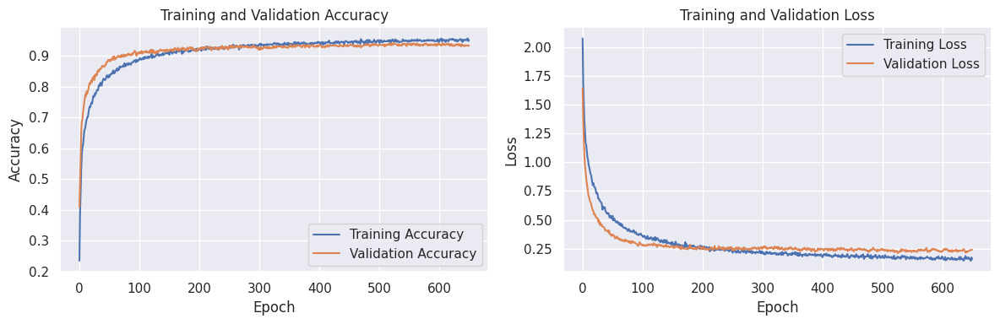

In [ ]:
history = model_sel.history

plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history['accuracy'], label='Training Accuracy')
plt.plot(history['val_accuracy'], label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(history['loss'], label='Training Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()